In [10]:
using Pkg
Pkg.activate(@__DIR__)
Pkg.instantiate()
using Revise, Distributions, GLMakie, Dates, DataFrames, CSV, BenchmarkTools, DataFramesMeta, LinearAlgebra, FFTW
using TrypColonies
import Serialization as s
Makie.inline!(true)  

  Activating project at `c:\Users\Andreas\Dropbox\phd\TrypColonies\TrypColonies`


true

### Choose local or static external data

In [11]:
data_path = find_data_path(local_data = false)

"C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\"

In [12]:
data_base = s.deserialize("data_base\\df.jls") 
data_base = @subset(data_base, :location .== data_path)   
@transform!(data_base, :doubling_time = 1 ./log2.(1 .+:growth_rate) ./3600)
first(data_base, 25)

Row,radius_tanget,scale_fac,agent_number,noise_dis,velo_var_relative,sweep_parameter,sampling_interval,L,path,walker_step_size,unix_date,run_time,location,name,N,parameter_increment,Diff_coe,adsorption_rate,storage,noise_strength,grid_recover_rate,iterations,growth_rate,Diameter_colony,parameter_steps,velocity_dis,radius_collision,date,walker_speed_phy,decay_rate,grid_strength,total_time,doubling_time,Δt_walker_min
,Int64,Int64,Int64,UnionAll,Float64,String,Int64,Tuple…,String,Int64,Float64,Float64,String,String,Tuple…,Float64,Float64,Float64,Float64,Float64,Float64,Int64,Float64?,Float64,Int64,UnionAll,Int64,DateTime,Float64,Float64,Int64,Float64,Float64?,Float64?
1,1,4,250000,Normal,1.5,radius_tanget,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\radius_tanget_sweep_threading_16_32_250000_time_seed_3543,3,1.73843e9,76925.0,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,radius_tanget_sweep_threading_16_32,"(1000, 1000)",2.0,7.0e-11,0.001,65.2002,1.2,15.0,1,1.157e-5,0.003,16,Normal,12,2025-02-01T17:34:38.663,5.0e-6,0.001,350,36000.0,16.6415,missing
2,10,4,250000,Normal,1.5,radius_collision,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\radius_collison_sweep_threading_16_32_250000_time_seed_0987,3,1.73872e9,1.3909e5,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,radius_collison_sweep_threading_16_32,"(1000, 1000)",1.0,7.0e-11,0.001,130.231,1.2,15.0,2,1.157e-5,0.003,16,Normal,1,2025-02-05T01:47:59.079,5.0e-6,0.001,350,36000.0,16.6415,missing
3,10,4,250000,Normal,1.5,Diff_coe,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\Diffcoeff_sweep_threading_16_32_250000_time_seed_4158,3,1.73893e9,80650.0,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,Diffcoeff_sweep_threading_16_32,"(1000, 1000)",1.0e-10,7.0e-11,0.001,65.196,1.2,15.0,1,1.157e-5,0.003,16,Normal,12,2025-02-07T13:26:48.070,5.0e-6,0.001,350,36000.0,16.6415,missing
4,10,4,250000,Normal,1.5,grid_strength,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\Grid_strength_threading_16_32_250000_time_seed_7711,3,1.73902e9,71310.8,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,Diffcoeff_sweep_threading_16_32,"(1000, 1000)",50.0,7.0e-11,0.001,65.1955,1.2,15.0,1,1.157e-5,0.003,16,Normal,12,2025-02-08T12:50:24.225,5.0e-6,0.001,150,36000.0,16.6415,missing
5,10,4,250000,Normal,1.5,grid_recover_rate,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\grid_recover_rate_sweep_threading_16_32_250000_time_seed_9404,3,1.73928e9,69813.6,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,grid_recover_rate_sweep_threading_16_32,"(1000, 1000)",2.0,7.0e-11,0.001,65.1391,1.2,10.0,1,1.157e-5,0.003,16,Normal,12,2025-02-11T13:06:59.890,5.0e-6,0.001,900,36000.0,16.6415,missing
6,15,4,250000,Normal,1.5,grid_recover_rate,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\grid_recover_rate_hard_walls_sweep_threading_16_32_250000_time_seed_1530,3,1.73937e9,71941.2,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,grid_recover_rate_hard_walls_sweep_threading_16_32,"(1000, 1000)",2.0,7.0e-11,0.001,65.1372,1.2,10.0,1,1.157e-5,0.003,16,Normal,12,2025-02-12T15:17:53.336,5.0e-6,0.001,1000,36000.0,16.6415,missing
7,15,4,250000,Normal,1.5,grid_strength,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\grid_strength_hard_walls_sweep_threading_16_32_250000_time_seed_6231,3,1.73946e9,71367.9,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,grid_strength_hard_walls_sweep_threading_16_32,"(1000, 1000)",200.0,7.0e-11,0.001,65.1786,1.2,15.0,1,1.157e-5,0.003,16,Normal,14,2025-02-13T14:40:01.538,5.0e-6,0.001,1000,36000.0,16.6415,missing
8,15,4,250000,Normal,1.5,Diff_coe,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\diff_coe_hard_walls_sweep_threading_16_32_250000_time_seed_1241,3,1.73955e9,795

### Chose the Data Sets based on some conditions 

In [13]:
sort!(data_base, :unix_date)

Row,radius_tanget,scale_fac,agent_number,noise_dis,velo_var_relative,sweep_parameter,sampling_interval,L,path,walker_step_size,unix_date,run_time,location,name,N,parameter_increment,Diff_coe,adsorption_rate,storage,noise_strength,grid_recover_rate,iterations,growth_rate,Diameter_colony,parameter_steps,velocity_dis,radius_collision,date,walker_speed_phy,decay_rate,grid_strength,total_time,doubling_time,Δt_walker_min
,Int64,Int64,Int64,UnionAll,Float64,String,Int64,Tuple…,String,Int64,Float64,Float64,String,String,Tuple…,Float64,Float64,Float64,Float64,Float64,Float64,Int64,Float64?,Float64,Int64,UnionAll,Int64,DateTime,Float64,Float64,Int64,Float64,Float64?,Float64?
1,1,4,250000,Normal,1.5,radius_tanget,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\radius_tanget_sweep_threading_16_32_250000_time_seed_3543,3,1.73843e9,76925.0,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,radius_tanget_sweep_threading_16_32,"(1000, 1000)",2.0,7.0e-11,0.001,65.2002,1.2,15.0,1,1.157e-5,0.003,16,Normal,12,2025-02-01T17:34:38.663,5.0e-6,0.001,350,36000.0,16.6415,missing
2,10,4,250000,Normal,1.5,radius_collision,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\radius_collison_sweep_threading_16_32_250000_time_seed_0987,3,1.73872e9,1.3909e5,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,radius_collison_sweep_threading_16_32,"(1000, 1000)",1.0,7.0e-11,0.001,130.231,1.2,15.0,2,1.157e-5,0.003,16,Normal,1,2025-02-05T01:47:59.079,5.0e-6,0.001,350,36000.0,16.6415,missing
3,10,4,250000,Normal,1.5,Diff_coe,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\Diffcoeff_sweep_threading_16_32_250000_time_seed_4158,3,1.73893e9,80650.0,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,Diffcoeff_sweep_threading_16_32,"(1000, 1000)",1.0e-10,7.0e-11,0.001,65.196,1.2,15.0,1,1.157e-5,0.003,16,Normal,12,2025-02-07T13:26:48.070,5.0e-6,0.001,350,36000.0,16.6415,missing
4,10,4,250000,Normal,1.5,grid_strength,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\Grid_strength_threading_16_32_250000_time_seed_7711,3,1.73902e9,71310.8,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,Diffcoeff_sweep_threading_16_32,"(1000, 1000)",50.0,7.0e-11,0.001,65.1955,1.2,15.0,1,1.157e-5,0.003,16,Normal,12,2025-02-08T12:50:24.225,5.0e-6,0.001,150,36000.0,16.6415,missing
5,10,4,250000,Normal,1.5,grid_recover_rate,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\grid_recover_rate_sweep_threading_16_32_250000_time_seed_9404,3,1.73928e9,69813.6,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,grid_recover_rate_sweep_threading_16_32,"(1000, 1000)",2.0,7.0e-11,0.001,65.1391,1.2,10.0,1,1.157e-5,0.003,16,Normal,12,2025-02-11T13:06:59.890,5.0e-6,0.001,900,36000.0,16.6415,missing
6,15,4,250000,Normal,1.5,grid_recover_rate,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\grid_recover_rate_hard_walls_sweep_threading_16_32_250000_time_seed_1530,3,1.73937e9,71941.2,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,grid_recover_rate_hard_walls_sweep_threading_16_32,"(1000, 1000)",2.0,7.0e-11,0.001,65.1372,1.2,10.0,1,1.157e-5,0.003,16,Normal,12,2025-02-12T15:17:53.336,5.0e-6,0.001,1000,36000.0,16.6415,missing
7,15,4,250000,Normal,1.5,grid_strength,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\grid_strength_hard_walls_sweep_threading_16_32_250000_time_seed_6231,3,1.73946e9,71367.9,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,grid_strength_hard_walls_sweep_threading_16_32,"(1000, 1000)",200.0,7.0e-11,0.001,65.1786,1.2,15.0,1,1.157e-5,0.003,16,Normal,14,2025-02-13T14:40:01.538,5.0e-6,0.001,1000,36000.0,16.6415,missing
8,15,4,250000,Normal,1.5,Diff_coe,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\diff_coe_hard_walls_sweep_threading_16_32_250000_time_seed_1241,3,1.73955e9,795

In [14]:
data_used = DataFrame(data_base[end,:])

Row,radius_tanget,scale_fac,agent_number,noise_dis,velo_var_relative,sweep_parameter,sampling_interval,L,path,walker_step_size,unix_date,run_time,location,name,N,parameter_increment,Diff_coe,adsorption_rate,storage,noise_strength,grid_recover_rate,iterations,growth_rate,Diameter_colony,parameter_steps,velocity_dis,radius_collision,date,walker_speed_phy,decay_rate,grid_strength,total_time,doubling_time,Δt_walker_min
,Int64,Int64,Int64,UnionAll,Float64,String,Int64,Tuple…,String,Int64,Float64,Float64,String,String,Tuple…,Float64,Float64,Float64,Float64,Float64,Float64,Int64,Float64?,Float64,Int64,UnionAll,Int64,DateTime,Float64,Float64,Int64,Float64,Float64?,Float64?
1,15,4,250000,Normal,1.5,grid_recover_rate,1200,"(0.015, 0.015)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\grid_recover_even_higher_valie_diamond&circle_gradient_grid_250000_time_seed_9046,3,1.7455e9,81716.9,C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\,grid_recover_even_higher_valie_diamond&circle_gradient_grid,"(1000, 1000)",0.5,7.0e-11,1.0e-5,65.7223,0.2,12.4444,1,2.13937e-5,0.003,16,Normal,16,2025-04-24T13:19:25.414,5.0e-6,0.001,8000,36000.0,9.0,0.1


### Chose analysis function of agents

An analysis function has to directly work on the .jls files and return a object per .jls file that can be plotted afterwards.  

In [15]:
path_vec = create_data_path_vector(data_used.path);

## One iteration 

In [16]:
s_p = data_used.sweep_parameter[1]
p_s = data_used.parameter_steps[1]
iter = data_used.iterations[1]
time_points = round(Int, data_used.total_time[1]/data_used.sampling_interval[1])
println(s_p)
println("total_time: ",data_used.total_time[1],"[s]", "   sampling_interval: ",data_used.sampling_interval[1],"[s]", "    time_points: ",time_points)
println("Para_Steps:",p_s)
println("Iterations:",iter)  

grid_recover_rate
total_time: 36000.0[s]   sampling_interval: 1200[s]    time_points: 30
Para_Steps:16
Iterations:1


In [17]:
update_theme!(Theme(fontsize = 20))

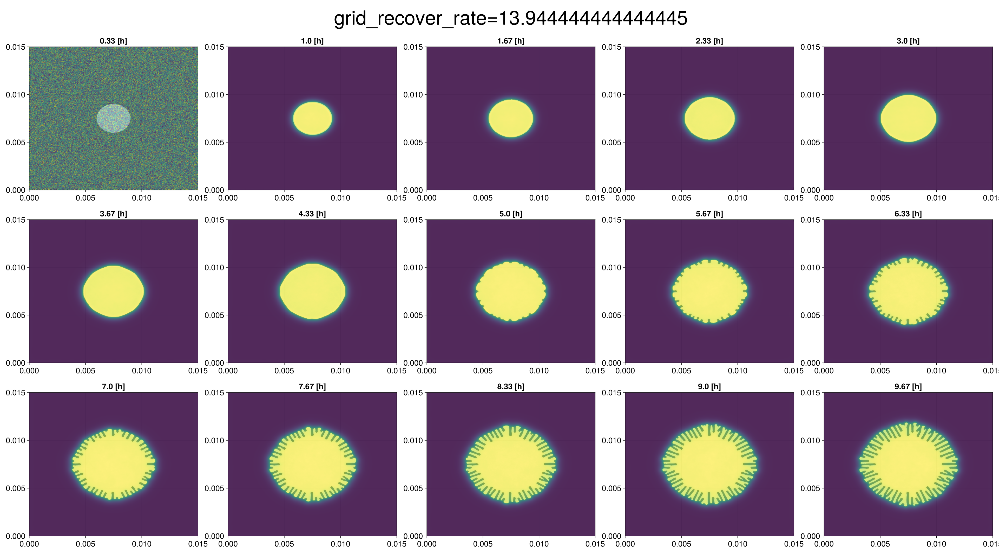

In [18]:
it = 4 * data_used.iterations[1] 
data = s.deserialize(path_vec[1][it])
range = 1:2:length(data[1])
plt_n = 1


fig = Figure(size = res_scaling(length(range), factor = 3.0 , plots = plt_n))

c = 0
for i in range 
    ax = Axis(fig[c÷5+1,(c%5+1)], title = "$(round(data_used.sampling_interval[1]*i/3600,digits = 2)) [h]")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][i]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][i], colormap = (:viridis,0.6))
    c += 1  
end
supertitle = Label(fig[0, :], "$(s_p)=$(getproperty(data[4].pa_ph,Symbol(s_p)))", fontsize = 50)

display(fig)
mkpath(data_used.path[1]*"\\analysis\\single")
save(data_used.path[1]*"\\analysis\\single\\heatmap_$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p))).png", fig, px_per_unit = 2)


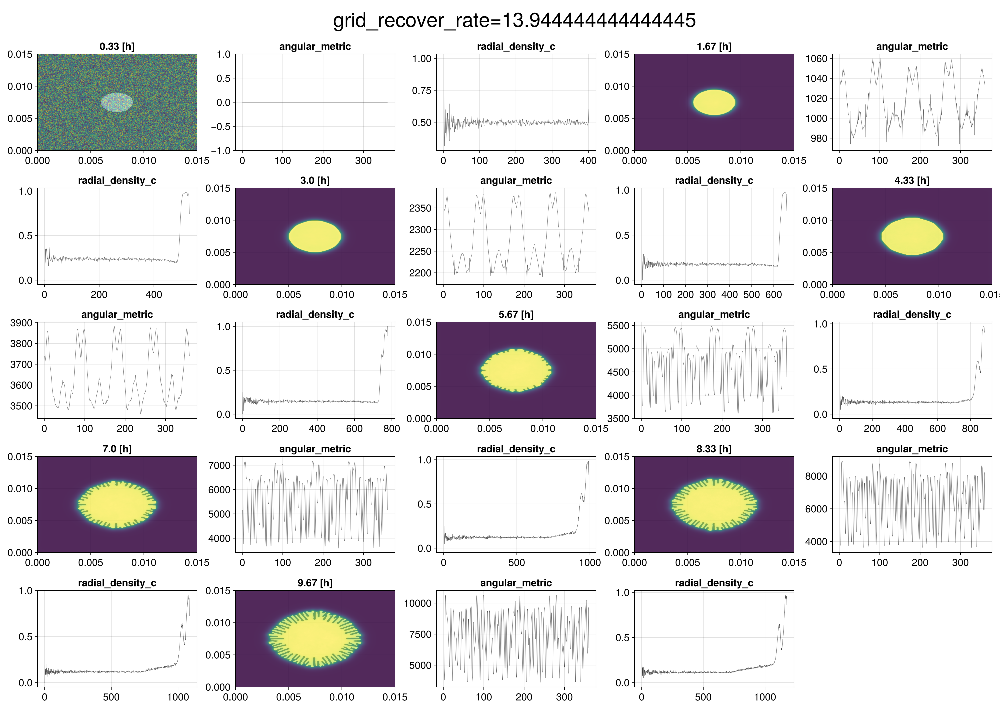

In [19]:
it = 4 * data_used.iterations[1] 
data = s.deserialize(path_vec[1][it])
datu = transform_data(data)
range = 1:4:length(data[1])
plt_n = 3
size = res_scaling(length(range), factor = 2 , plots = plt_n)
fig2 = Figure(size =size)
c = 0
for i in range 
    ax = Axis(fig2[c÷5+1,(c%5+1)], title = "$(round(data_used.sampling_interval[1]*i/3600,digits = 2)) [h]")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][i]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][i], colormap = (:viridis,0.6))
    c += 1
    ax2 = Axis(fig2[c÷5+1,(c%5+1)], title = "angular_metric")
    lines!(ax2, angular_metric(datu[i]...), color = :black, linewidth = .3)
    c += 1  
    ax3 = Axis(fig2[c÷5+1,(c%5+1)], title = "radial_density_c")
    lines!(ax3, radial_density_c(datu[i]...), color = :black, linewidth = .3)
    c += 1  
end
supertitle = Label(fig2[0, :], "$(s_p)=$(getproperty(data[4].pa_ph,Symbol(s_p)))", fontsize = 40)

display(fig2)

mkpath(data_used.path[1]*"\\analysis\\single")
save(data_used.path[1]*"\\analysis\\single\\heatmap_wi_$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_angular_radial.png", fig2, size = size )

## Compare data in one sweep


In [20]:
s_p = data_used.sweep_parameter[1]
p_s = data_used.parameter_steps[1]
iter = data_used.iterations[1]
time_points = round(Int, data_used.total_time[1]/data_used.sampling_interval[1])
println(s_p)
println("total_time: ",data_used.total_time[1],"[s]", "   sampling_interval: ",data_used.sampling_interval[1],"[s]", "    time_points: ",time_points)
println("Para_Steps:",p_s)
println("Iterations:",iter)  

grid_recover_rate
total_time: 36000.0[s]   sampling_interval: 1200[s]    time_points: 30
Para_Steps:16
Iterations:1


In [21]:
time_point = 30
it_u = data_used.iterations[1]  
plt_n = 3
para_range = 1:1:p_s

1:1:16

In [22]:
data = s.deserialize(path_vec[1][1*it_u])

(Vector{TrypColonies.agent}[[TrypColonies.agent(2063, 2050, 0.9995965384680858, 0.02840352588360391), TrypColonies.agent(1662, 2014, 0.9770632194581225, -0.2129494427842648), TrypColonies.agent(2087, 1662, 0.9563378811649684, -0.2922633351087659), TrypColonies.agent(2257, 1799, -0.9999155011900349, -0.012999633836427452), TrypColonies.agent(1999, 1948, 0.818160017857457, -0.5749905957313438), TrypColonies.agent(2247, 1783, 0.6164322942231573, -0.7874079162916606), TrypColonies.agent(2067, 2116, 0.9869722926960376, -0.16089031496745565), TrypColonies.agent(1691, 2039, 0.1407349097312771, -0.9900473146183112), TrypColonies.agent(2163, 1698, 0.5573608006657369, -0.8302704004607467), TrypColonies.agent(1944, 1924, -0.5585287263866315, 0.8294851787711022)  …  TrypColonies.agent(2374, 1983, -0.008796213358835778, -0.9999613125669142), TrypColonies.agent(1816, 2054, 0.3421496511508983, -0.9396454736853249), TrypColonies.agent(2096, 1634, 0.5862231200397742, 0.8101496488494163), TrypColonies.a

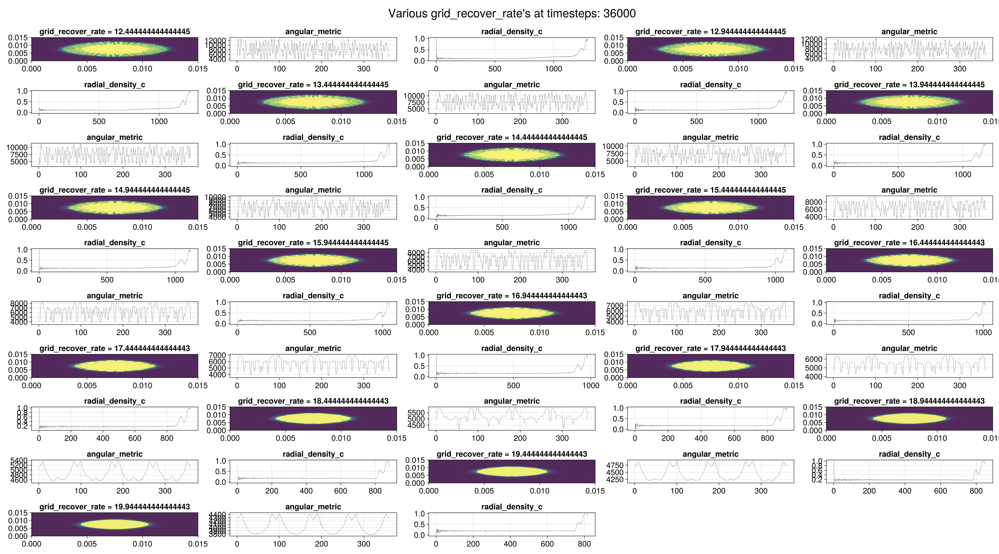

In [23]:
size  = res_scaling(length(para_range), factor = 3 , plots = plt_n)
fig3 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig3[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
    ax2 = Axis(fig3[c÷5+1,(c%5+1)], title = "angular_metric")
    lines!(ax2, angular_metric(datu[time_point]...), color = :black, linewidth = .3)
    c += 1  
    ax3 = Axis(fig3[c÷5+1,(c%5+1)], title = "radial_density_c")
    lines!(ax3, radial_density_c(datu[time_point]...), color = :black, linewidth = .3)
    c += 1 
end

supertitle = Label(fig3[0, :], "Various $(s_p)'s at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig3)

mkpath(data_used.path[1]*"\\analysis")
save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_angular_radial.png", fig3, size = size)

## Area gain and adsorpted material 

In [24]:
time_point = 30 
it_u = data_used.iterations[1]  
plt_n = 3
para_range = 1:1:p_s

1:1:16

In [25]:
data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_area_adsorbed.png"

"C:\\Users\\Andreas\\Desktop\\simulation_data_julia_knecht\\grid_recover_even_higher_valie_diamond&circle_gradient_grid_250000_time_seed_9046\\analysis\\grid_recover_rate_19.944444444444443_time_point_30_area_adsorbed.png"

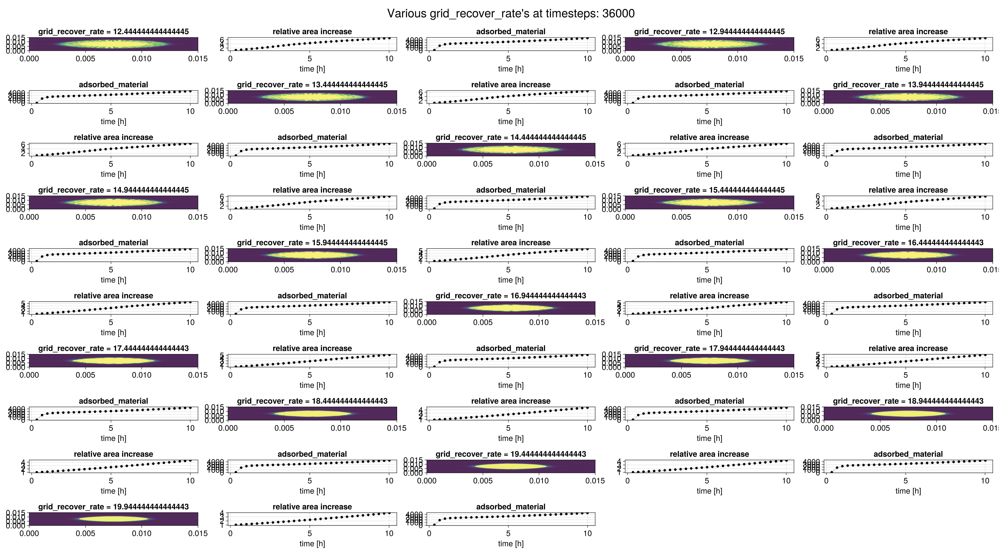

In [26]:
size = res_scaling(length(para_range), factor = 3 , plots = plt_n)
fig4 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig4[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
    ax2 = Axis(fig4[c÷5+1,(c%5+1)], title = "relative area increase", xlabel = "time [h]")
    scatterlines!(ax2,(1:length(datu)).*(1/3), [area_gain(x...) for x in datu], color = :black, linewidth = .3)
    c += 1  
    ax3 = Axis(fig4[c÷5+1,(c%5+1)], title = "adsorbed_material",xlabel = "time [h]")
    scatterlines!(ax3, (1:length(datu)).*(1/3),[adsorbed_material(x...) for x in datu], color = :black, linewidth = .3)
    c += 1 
end

supertitle = Label(fig4[0, :], "Various $(s_p)'s at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig4)


mkpath(data_used.path[1]*"\\analysis")
save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_area_adsorbed.png", fig4, size = size)

In [27]:
time_point = 30 
it_u = data_used.iterations[1]  
plt_n = 3
para_range = 1:1:p_s


1:1:16

In [28]:
data = length(s.deserialize(path_vec[1][1*it_u]))

4

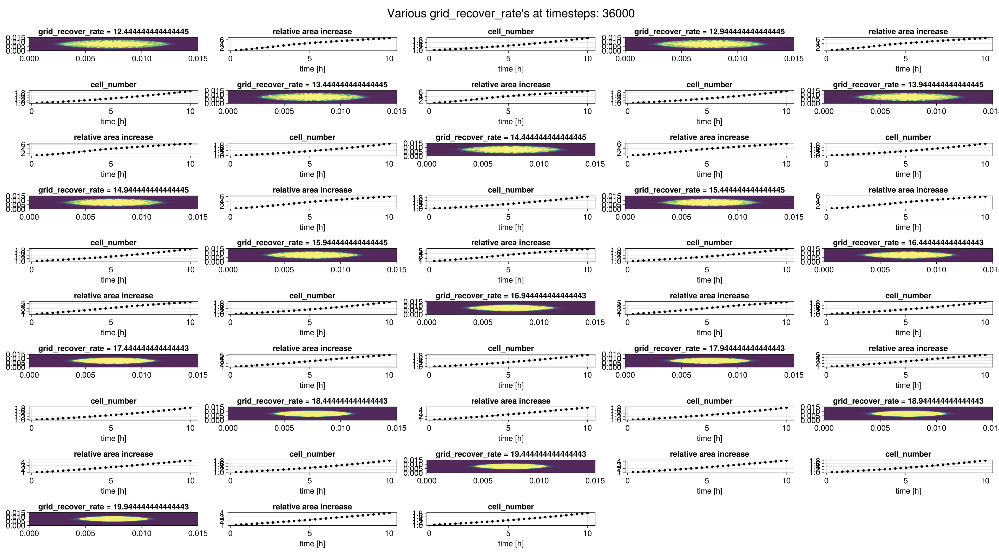

In [29]:
size = res_scaling(length(para_range), factor = 3 , plots = plt_n)
fig5 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig5[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
    ax2 = Axis(fig5[c÷5+1,(c%5+1)], title = "relative area increase", xlabel = "time [h]")
    scatterlines!(ax2,(1:length(datu)).*(1/3) ,[area_gain(x...) for x in datu], color = :black, linewidth = .3)
    c += 1  
    ax3 = Axis(fig5[c÷5+1,(c%5+1)], title = "cell_number",xlabel = "time [h]")
    scatterlines!(ax3,(1:length(datu)).*(1/3), [cell_gain(x...) for x in datu], color = :black, linewidth = .3)
    c += 1 
end

supertitle = Label(fig5[0, :], "Various $(s_p)'s at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig5)


mkpath(data_used.path[1]*"\\analysis")
save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_area__cells_adsorbed.png", fig5, size = size)

name_analysis = "comparison_corfunc_circle" 

analysis_path = "analysis\\$cor_func"*string(data_used[1,:]["agent_number"])*"$(name_analysis)\\"

mkpath(analysis_path)

save(analysis_path*"fig.pdf",fig)
analysis_data = (data_used,anaylsis_data, sweep_parameter)


s.serialize(analysis_path*"data.jls",analysis_data)

In [30]:
function roughness(metric, OG_size::Int)
   return std(metric/OG_size)
end
    

roughness (generic function with 1 method)

## Metrics

In [31]:
data = s.deserialize(path_vec[1][1*it_u])
datu = transform_data(data)
Og_size = og_size(datu[1]...) 
it_u = data_used.iterations[1]  
plt_n = 3
para_range = collect(1:5:p_s)
length_data = round(Int,data_used.total_time[1]/data_used.sampling_interval[1])

30

In [32]:
#para_range = [1,3,4, 5, 11]

In [33]:
Og_size

502625

In [34]:
angular_metric_vec = [[zeros(Int, 360) for i in 1:length_data] for j in 1:length(para_range)];
pair_metric_vec = [[zeros(Float64, 360) for i in 1:length_data] for j in 1:length(para_range)];
area_gain_vec = [[0.0 for i in 1:length_data] for j in 1:length(para_range)];
length(angular_metric_vec);

## Create Data

In [35]:
Threads.@threads for (i,x) in collect(enumerate(para_range))
    data = s.deserialize(path_vec[1][x*it_u])
    datu = transform_data(data)
    pair_metric_vec[i] = [pair_cor_metric(datu[j]... ; max_samples = 10000000) for j in 1:length_data]

end

In [36]:
Threads.@threads for (i,x) in collect(enumerate(para_range))
    data = s.deserialize(path_vec[1][x*it_u])
    datu = transform_data(data)
    angular_metric_vec[i] = [angular_metric(datu[j]...) for j in 1:length_data]
    area_gain_vec[i] = [area_gain(datu[j]...) for j in 1:length_data]
end

In [37]:
"""fourier_vec = [[zeros(Float64, 360) for i in 1:length_data] for j in 1:length(para_range)];
@transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))
    @transform(:abs_cov = [abs.(x[2:360÷2]) for x in :fourier_conv], :abs_OG = [abs.(x[2:360÷2]) for x in :fourier_OG])
    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)

   """ 

"fourier_vec = [[zeros(Float64, 360) for i in 1:length_data] for j in 1:length(para_range)];\n@transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))\n    @transform(:abs_cov = [abs.(x[2:360÷2]) for x in :fourier_conv], :abs_OG = [abs.(x[2:360÷2]) for x in :fourier_OG])\n    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)\n\n   "

In [38]:
function fourier_ik(metric, Og_size)
    fourier = fft(metric)
    fourier = abs.(fourier[2:360÷2])
    fourier = fourier ./ Og_size
    return sum(fourier)
end

fourier_ik (generic function with 1 method)

In [39]:
hans = fourier_ik(angular_metric_vec[1][1], Og_size)

0.0

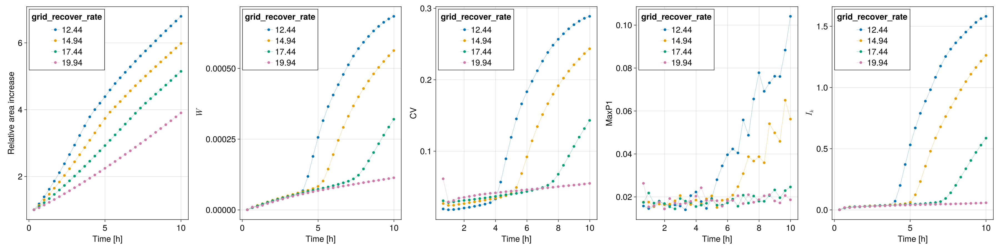

In [65]:
size = (2400, 600)
fig6 = Figure(size = size)
ax = Axis(fig6[1,1], ylabel = "Relative area increase", xlabel = "Time [h]")
ax2 = Axis(fig6[1,2], ylabel = L"W", xlabel = "Time [h]")
ax3 = Axis(fig6[1,3], ylabel = "CV", xlabel = "Time [h]")
ax4 = Axis(fig6[1,4], ylabel = "MaxP1", xlabel = "Time [h]")
ax5 = Axis(fig6[1,5], ylabel = L"I_k", xlabel = "Time [h]")
for (i,p) in enumerate(para_range)
    metric_single =angular_metric_vec[i]
    # normalize by area 
    
    scatterlines!(ax, (1:length(datu)).*(1/3), area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))") 
    scatterlines!(ax2, (1:length(datu)).*(1/3),[roughness(x,Og_size) for x in metric_single]./area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
  
    #if i < 5
        scatterlines!(ax3, (1:length(datu)).*(1/3), [std(x)/mean(x) for x in metric_single][1:end], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
        scatterlines!(ax4, (1:length(datu)).*(1/3), [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][1:end], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
    #else
    """

        scatterlines!(ax3, (5:length(datu)).*(1/3), [std(x)/mean(x) for x in metric_single][5:end], linewidth = .3, label= "$(p)_CV")
        scatterlines!(ax4, (5:length(datu)).*(1/3), [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][5:end], linewidth = .3, label= "$(p)_MaxP1")
      """
    scatterlines!(ax5, (1:length(datu)).*(1/3), [fourier_ik(x,Og_size) for x in metric_single]./area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
end
axislegend(ax,"$(s_p)", position = :lt)
axislegend(ax2,"$(s_p)", position = :lt)
axislegend(ax3,"$(s_p)", position = :lt)
axislegend(ax4,"$(s_p)", position = :lt)
axislegend(ax5,"$(s_p)",position = :lt)

save(data_used.path[1]*"\\analysis\\roughness.png", fig6, size = size)
fig6

In [41]:
data_used.parameter_increment[1]*(1-1)+data_used[!,s_p][1]

12.444444444444445

In [42]:
data_used[!,s_p][1]

12.444444444444445

In [43]:
data_used.parameter_increment[1]

0.5

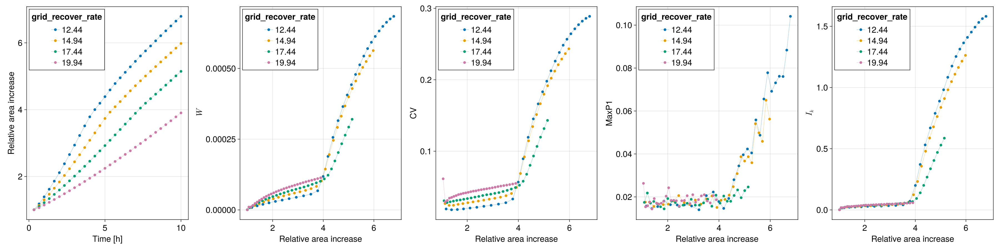

In [64]:
fig7 = Figure(size = (2400, 600))
ax = Axis(fig7[1,1], ylabel = "Relative area increase", xlabel = "Time [h]")
ax2 = Axis(fig7[1,2], ylabel = L"W", xlabel = "Relative area increase")
ax3 = Axis(fig7[1,3], ylabel = "CV", xlabel = "Relative area increase")
ax4 = Axis(fig7[1,4], ylabel = "MaxP1", xlabel = "Relative area increase")
ax5 = Axis(fig7[1,5], ylabel = L"I_k", xlabel = "Relative area increase")
for (i,p) in enumerate(para_range)
    metric_single =angular_metric_vec[i]
    # normalize by area 
    
    scatterlines!(ax, (1:length(datu)).*(1/3), area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))") 
    scatterlines!(ax2, area_gain_vec[i],[roughness(x,Og_size) for x in metric_single]./area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
  
    #if i < 5
        scatterlines!(ax3, area_gain_vec[i], [std(x)/mean(x) for x in metric_single][1:end], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
        scatterlines!(ax4, area_gain_vec[i], [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][1:end], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
    #else
    """

        scatterlines!(ax3, (5:length(datu)).*(1/3), [std(x)/mean(x) for x in metric_single][5:end], linewidth = .3, label= "$(p)_CV")
        scatterlines!(ax4, (5:length(datu)).*(1/3), [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][5:end], linewidth = .3, label= "$(p)_MaxP1")
      """
    scatterlines!(ax5, area_gain_vec[i], [fourier_ik(x,Og_size) for x in metric_single]./area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
end
axislegend(ax,"$(s_p)", position = :lt)
axislegend(ax2,"$(s_p)", position = :lt)
axislegend(ax3,"$(s_p)", position = :lt)
axislegend(ax4,"$(s_p)", position = :lt)
axislegend(ax5,"$(s_p)",position = :lt)

save(data_used.path[1]*"\\analysis\\roughness_area_n.png", fig7)
fig7

In [59]:
round(data_used.parameter_increment[1]*(3-1)+data_used[!,s_p][1], digits = 2)

13.44

In [60]:
round(data_used.parameter_increment[1]*(3-1)+data_used[!,s_p][1], digits =2)

13.44

In [51]:
round(10.12321, digits = 2)

10.12

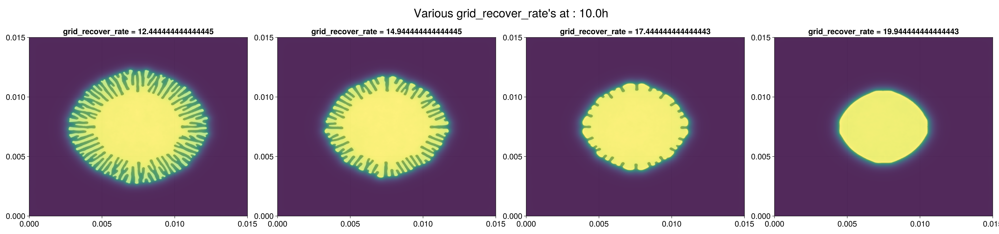

In [45]:
size = res_scaling(length(para_range), factor = 3 , plots = 1)
fig7 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig7[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
end

supertitle = Label(fig7[0, :], "Various $(s_p)'s at : $(time_point *data_used.sampling_interval[1]/3600)h", fontsize = 30)
#supertitle = Label(fig7[0, :], "Various α  at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig7)

save(data_used.path[1]*"\\analysis\\final_state.png", fig7)
#mkpath(data_used.path[1]*"\\analysis")
#save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_area__cells_adsorbed.png", fig5, size = size)

In [46]:
data = s.deserialize(path_vec[1][3])
datu = transform_data(data)

30-element Vector{Vector{Any}}:
 [TrypColonies.agent[TrypColonies.agent(2196, 1758, -0.8587352372448247, -0.5124195471623566), TrypColonies.agent(2153, 1724, 0.9993004267996038, 0.03739862294429598), TrypColonies.agent(1985, 2242, -0.9980161562865429, -0.06295833376952331), TrypColonies.agent(2351, 2065, 0.4015454327983, -0.9158391045368318), TrypColonies.agent(1733, 2234, 0.6383778556406587, 0.7697231407640245), TrypColonies.agent(1743, 2033, 0.00020367320369530035, -0.9999999792586128), TrypColonies.agent(1933, 2005, -0.9407367854479441, -0.33913758344522754), TrypColonies.agent(1900, 2386, 0.08229580338226226, 0.9966079473622855), TrypColonies.agent(2088, 2158, 0.8877292517787501, 0.4603659148289984), TrypColonies.agent(2182, 1778, -0.9774011348268636, -0.21139305012028933)  …  TrypColonies.agent(2155, 2045, -0.9987997401808185, -0.048980394187159236), TrypColonies.agent(1661, 1971, -0.027607511454211645, 0.9996188400141854), TrypColonies.agent(2069, 2142, 0.13677360515552345, -0.99

In [47]:
metric

LoadError: UndefVarError: `metric` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

In [ ]:
metric = [angular_metric(x...) for x in datu]

30-element Vector{Vector{Int64}}:
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
 [394, 416, 410, 405, 405, 405, 408, 408, 408, 402  …  414, 408, 408, 408, 404, 400, 399, 402, 401, 394]
 [960, 961, 962, 962, 963, 966, 968, 969, 970, 968  …  976, 968, 971, 970, 965, 967, 961, 962, 959, 960]
 [1592, 1606, 1601, 1600, 1605, 1607, 1610, 1611, 1612, 1611  …  1619, 1615, 1613, 1615, 1615, 1608, 1608, 1601, 1601, 1592]
 [2308, 2307, 2317, 2313, 2313, 2322, 2326, 2327, 2328, 2324  …  2337, 2337, 2338, 2331, 2326, 2326, 2315, 2315, 2317, 2308]
 [3088, 3089, 3091, 3090, 3093, 3096, 3106, 3111, 3111, 3110  …  3122, 3119, 3121, 3114, 3112, 3106, 3099, 3096, 3094, 3088]
 [3924, 3929, 3927, 3934, 3939, 3943, 3949, 3953, 3957, 3956  …  3967, 3964, 3963, 3958, 3956, 3943, 3936, 3938, 3934, 3924]
 [4807, 4811, 4824, 4826, 4831, 4838, 4843, 4852, 4856, 4858  …  4866, 4867, 4867, 4857, 4848, 4834, 4825, 4821, 4822, 4807]
 [5727, 5739, 5739, 5748, 5756, 5770, 5773, 5776, 5794, 5794  …  5

In [ ]:
length.(metric)

30-element Vector{Int64}:
 360
 360
 360
 360
 360
 360
 360
 360
 360
 360
   ⋮
 360
 360
 360
 360
 360
 360
 360
 360
 360